In [0]:
import pickle
import requests
import cv2
import numpy as np
import zipfile
import io
import csv
from matplotlib import pyplot as plt
import glob
import shutil

In [0]:
# from google.colab import drive
# drive.mount('/content/drive')

In [0]:

def download_file_from_google_drive(id, destination):
    URL = "https://docs.google.com/uc?export=download"

    session = requests.Session()

    response = session.get(URL, params = { 'id' : id }, stream = True)
    token = get_confirm_token(response)

    if token:
        params = { 'id' : id, 'confirm' : token }
        response = session.get(URL, params = params, stream = True)

    save_response_content(response, destination)    

def get_confirm_token(response):
    for key, value in response.cookies.items():
        if key.startswith('download_warning'):
            return value

    return None

def save_response_content(response, destination):
    CHUNK_SIZE = 32768

    with open(destination, "wb") as f:
        for chunk in response.iter_content(CHUNK_SIZE):
            if chunk: # filter out keep-alive new chunks
                f.write(chunk)

In [0]:
#get test set
file_id = '1E6EeAHrLuuenoMgHWnjzrBaNhsc6KV5l'
destination = 'test_set.zip'
download_file_from_google_drive(file_id, destination)
data = zipfile.ZipFile('test_set.zip')
data.extractall('test_set')

use FAN with SOLVEPNP

In [0]:
#dawnload script file files
import requests
file_id = '1HzHIekfdv1IbTSoRBXXiYkg-QpDhA5Vu'
destination = 'useFAN.py'
download_file_from_google_drive(file_id, destination)

#dawnload pkl file
import requests
file_id = '1v2SR8tX-6C6PpGQytXAUaE3LPoFTmrZ0'
destination = 'model.pkl'
download_file_from_google_drive(file_id, destination)



In [0]:
# main func of script runs and create model,
import useFAN
fa = useFAN.main()
data = zipfile.ZipFile('test_set.zip')
data.extractall('test_set')
# runs on validation set and shows 10 imgs with largest error (in deg), 
#and runs on test set- show imgs and create csv file with results

# useFAN.valid_and_test(fa)
#try again dawnload file, 
#have enable dawnload files in chrom
# try:
#     from google.colab import files
#     IN_COLAB = True
# except:
#     IN_COLAB = False

# if(IN_COLAB):
#     files.download('res_file.csv')

Downloading: "https://www.adrianbulat.com/downloads/python-fan/s3fd-619a316812.pth" to /root/.cache/torch/checkpoints/s3fd-619a316812.pth


Downloading: "https://www.adrianbulat.com/downloads/python-fan/2DFAN4-11f355bf06.pth.tar" to /root/.cache/torch/checkpoints/2DFAN4-11f355bf06.pth.tar


save model to PKL file

In [0]:
from skimage import io
import pickle


axis = np.float32([[-80,-80,0], [-80,80,0], [80,80,0], [80,-80,0],
                [-110,-110,-110],[-110,110,-110],[110,110,-110],[110,-110,-110] ])
axis = axis*0.6
detect = useFAN.Model( useFAN.mat, useFAN.cameraMatrix, axis)
#save to pkl file
# with open('model.pkl', 'wb') as model_file:
#   pickle.dump(detect, model_file)



load PKL file for predict

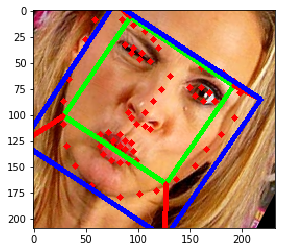

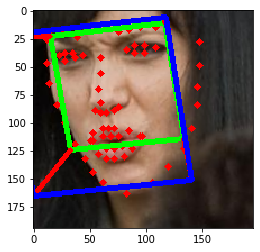

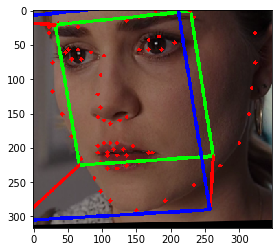

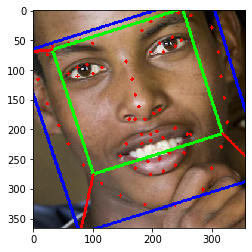

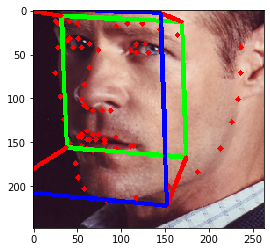

...

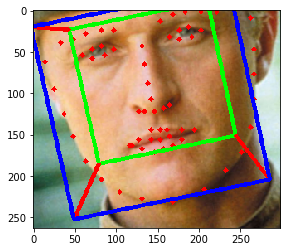

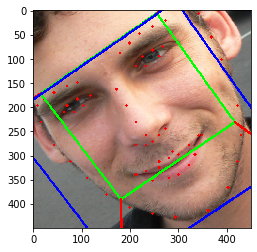

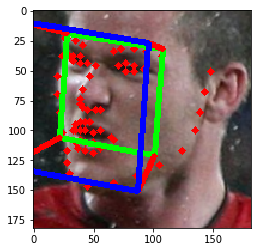

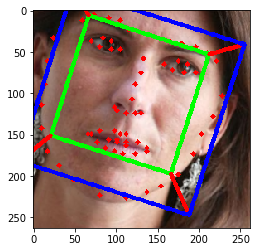

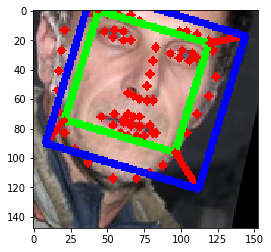

In [0]:

with open('model.pkl', 'rb') as f:
    mo = pickle.load(f)
#have send path of img dir to predict. if dont check 'test_set
pred = mo()





In [0]:
#have enable dawnload files in chrom
try:
    from google.colab import files
    IN_COLAB = True
except:
    IN_COLAB = False

if(IN_COLAB):
    files.download('res_file.csv')

create dataset - csv file

In [0]:
# #create csv file - for 300W dataset
file_id = '1yaiNcoyjHGWpX3ViuW70GE0EeHyZPVl4'
destination = 'create_csv.py'
download_file_from_google_drive(file_id, destination)
# import create_csv

TENSOR-FLOW model

In [0]:
#tensorflow model

# Use some functions from tensorflow_docs
!pip install -q git+https://github.com/tensorflow/docs
!pip install -q pyyaml h5py  # Required to save models in HDF5 format

try:
  # %tensorflow_version only exists in Colab.
  %tensorflow_version 2.x
except Exception:
  pass
import tensorflow as tf
from __future__ import absolute_import, division, print_function, unicode_literals



TensorFlow 2.x selected.


In [0]:
#dawnload script fills for tf model
import requests
file_id = '1I-VrhPY0FBS9BrXlMDqnstJjScrSxqtW'
destination = 'tf_predict.py'
download_file_from_google_drive(file_id, destination)
file_id = '1wfBEgyxgIeIqymG-JXMHl-6OG8XQMkCH'
destination = 'tf_model.py'
download_file_from_google_drive(file_id, destination)
#get h5 model file
file_id = '1C4ZPvMqssaoKjK_WeA7A5QKdG8YfRe8L'
destination = 'my_model.h5'
download_file_from_google_drive(file_id, destination)

In [0]:

##to run train and test:
# import tf_model


In [0]:
#predict with tf model -have send dir-path
import tf_predict as tf_predict
tf_predict.predict_dir('test_set')

Using TensorFlow backend.


2.1.0


In [0]:
#have enable dawnload files in chrom
try:
    from google.colab import files
    IN_COLAB = True
except:
    IN_COLAB = False

if(IN_COLAB):
    files.download('tf_res_file.csv')

PYTORCH model

In [0]:
#dawnload script fills for tf model
import requests
file_id = '1x2Y-Eo6lXusWNLMMduuahSOLuYb3_nja'
destination = 'torch_predict.py'
download_file_from_google_drive(file_id, destination)
file_id = '1en7I9VwPz70D6Vk3dof5CduThvggVeAW'
destination = 'torch_model.py'
download_file_from_google_drive(file_id, destination)
#get wehight within model file


In [0]:
#import model for train, and test
# import torch_model

In [0]:
import torch_predict
torch_predict.predict_dir('test_set')

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/checkpoints/vgg16-397923af.pth


In [0]:
#have enable dawnload files in chrom
try:
    from google.colab import files
    IN_COLAB = True
except:
    IN_COLAB = False

if(IN_COLAB):
    files.download('torch_res_file.csv')